<a href="https://colab.research.google.com/github/agbleze/image_background_remover/blob/main/backgroundremoval_pipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pwd

'/content'

In [ ]:
ls

drive/  sample_data/


In [ ]:
!git clone "https://github.com/nikhilroxtomar/Human-Image-Segmentation-with-DeepLabV3Plus-in-TensorFlow.git"

Cloning into 'Human-Image-Segmentation-with-DeepLabV3Plus-in-TensorFlow'...
remote: Enumerating objects: 130, done.
remote: Counting objects: 100% (130/130), done.
remote: Compressing objects: 100% (99/99), done.
remote: Total 130 (delta 29), reused 126 (delta 26), pack-reused 0
Receiving objects: 100% (130/130), 44.77 MiB | 22.34 MiB/s, done.
Resolving deltas: 100% (29/29), done.


In [ ]:
!mkdir('background_removal_project')

/bin/bash: -c: line 0: syntax error near unexpected token `'background_removal_project''
/bin/bash: -c: line 0: `mkdir('background_removal_project')'


In [ ]:
ls

drive/                                                      sample_data/
Human-Image-Segmentation-with-DeepLabV3Plus-in-TensorFlow/


In [ ]:
!git clone 'https://github.com/nikhilroxtomar/Remove-Photo-Background-using-TensorFlow.git'

Cloning into 'Remove-Photo-Background-using-TensorFlow'...
remote: Enumerating objects: 24, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (22/22), done.
remote: Total 24 (delta 5), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (24/24), 14.97 MiB | 4.93 MiB/s, done.


In [ ]:
!ls

drive
Human-Image-Segmentation-with-DeepLabV3Plus-in-TensorFlow
Remove-Photo-Background-using-TensorFlow
sample_data


In [ ]:
!cd "Remove-Photo-Background-using-TensorFlow"

In [ ]:
!pwd

/content


In [ ]:
ls

drive/
Human-Image-Segmentation-with-DeepLabV3Plus-in-TensorFlow/
Remove-Photo-Background-using-TensorFlow/
sample_data/


In [ ]:
cd /content/Remove-Photo-Background-using-TensorFlow

/content/Remove-Photo-Background-using-TensorFlow


In [ ]:
pwd

'/content/Remove-Photo-Background-using-TensorFlow'

In [ ]:
!ls

images	metrics.py  README.md  remove_bg  run.py


In [ ]:
!python run.py

Traceback (most recent call last):
  File "/content/Remove-Photo-Background-using-TensorFlow/run.py", line 31, in <module>
    model = tf.keras.models.load_model("model.h5")
  File "/usr/local/lib/python3.10/dist-packages/keras/saving/saving_api.py", line 212, in load_model
    return legacy_sm_saving_lib.load_model(
  File "/usr/local/lib/python3.10/dist-packages/keras/utils/traceback_utils.py", line 70, in error_handler
    raise e.with_traceback(filtered_tb) from None
  File "/usr/local/lib/python3.10/dist-packages/keras/saving/legacy/save.py", line 230, in load_model
    raise IOError(
OSError: No file or directory found at model.h5


In [ ]:
import gdown

In [ ]:
!gdown "17QKxSIBFhyJoDps93-sCVHnVV6UWS1sG"

Downloading...
From: https://drive.google.com/uc?id=17QKxSIBFhyJoDps93-sCVHnVV6UWS1sG
To: /content/Remove-Photo-Background-using-TensorFlow/model.h5
100% 215M/215M [00:05<00:00, 40.9MB/s]


In [ ]:
!python run.py

1/1 [==============================] - 3s 3s/step
100% 3/3 [00:11<00:00,  3.79s/it]


In [ ]:
!ls

images	metrics.py  model.h5  __pycache__  README.md  remove_bg  run.py


In [ ]:
import os
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"

import numpy as np
import cv2
import pandas as pd
from glob import glob
from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.utils import CustomObjectScope
from metrics import dice_loss, dice_coef, iou
#from train import create_dir

""" Global parameters """
H = 512
W = 512

In [ ]:
np.random.seed(2023)
tf.random.set_seed(2023)

In [ ]:
from google.colab.patches import cv2_imshow

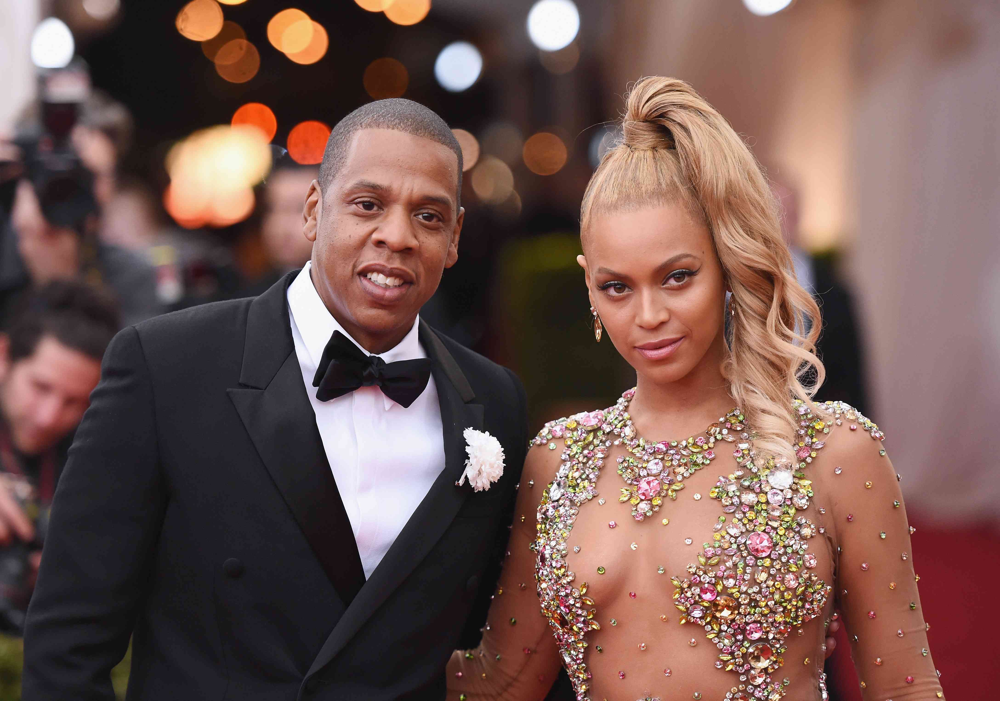

In [ ]:
img_path = "/content/Remove-Photo-Background-using-TensorFlow/images/beyonceandjay-z-Mikecoppola-c59229db80174b3290431f66eea3d8ff.jpg"

img1 = cv2.imread(img_path)

cv2_imshow(img1)





In [ ]:
with CustomObjectScope({'iou': iou, 'dice_coef': dice_coef, 'dice_loss': dice_loss}):
        model = tf.keras.models.load_model("model.h5")


In [ ]:
#model.summary()

In [ ]:
cv2.IMREAD_COLOR

image = cv2.imread(img_path, cv2.IMREAD_COLOR)
h, w, _ = image.shape
x = cv2.resize(image, (W, H))
x = x/255.0
x = x.astype(np.float32)
x = np.expand_dims(x, axis=0)

In [ ]:
DEFAULT_IMG_HEIGHT = 512
DEFAULT_IMG_WIDTH = 512

def image_preprocess(image_path):
  image = cv2.imread(image_path, cv2.IMREAD_COLOR)
  img_height, img_width, _ = image.shape
  image_resize = cv2.resize(image, (DEFAULT_IMG_WIDTH, DEFAULT_IMG_HEIGHT))
  image_rescale = image_resize/255.0
  img_type_converted = image_rescale.astype(np.float32)
  img_dim_expand = np.expand_dims(img_type_converted, axis=0)








In [ ]:
H

512

In [ ]:
y = model.predict(x)[0]
y = cv2.resize(y, (w, h))
y = np.expand_dims(y, axis=-1)

1/1 [==============================] - 4s 4s/step


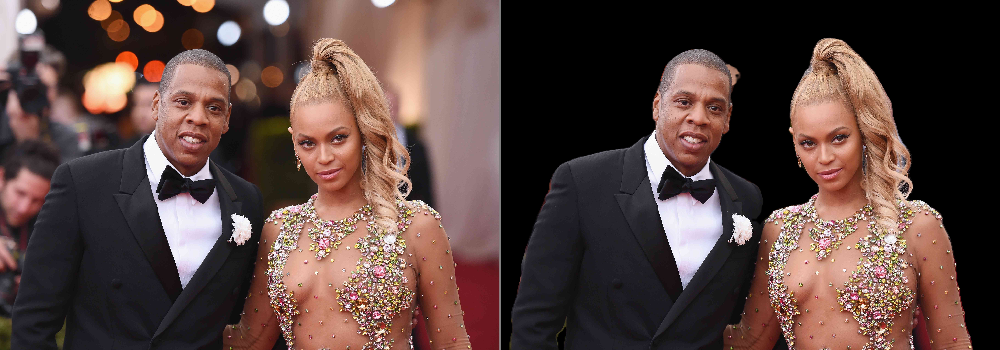

In [ ]:
masked_image = image * y
line = np.ones((h, 10, 3)) * 128
cat_images = np.concatenate([image, line, masked_image], axis=1)
#cv2.imwrite(f"test_images/mask/{name}.png", cat_images)



cv2_imshow(cat_images)

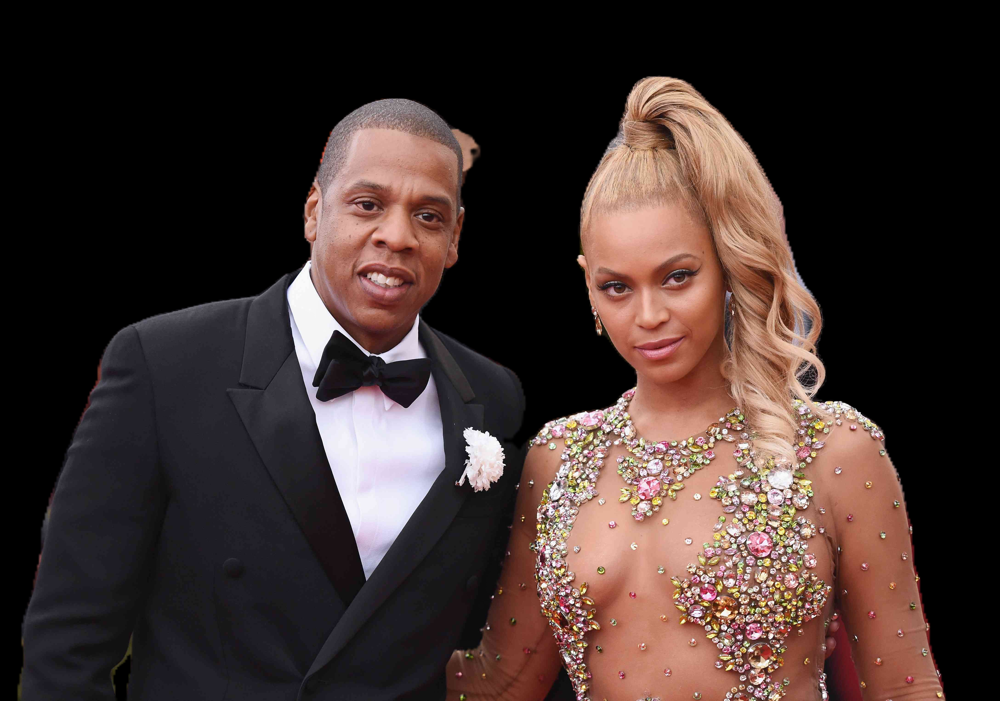

In [ ]:
cv2_imshow(masked_image)

In [ ]:
""" Prediction """
y = model.predict(x)[0]
y = cv2.resize(y, (w, h))
y = np.expand_dims(y, axis=-1)
y = y > 0.5

photo_mask = y
background_mask = np.abs(1-y)

1/1 [==============================] - 2s 2s/step


In [ ]:
def segment_image(model, preprocessed_img, img_resize_height=DEFAULT_IMG_HEIGHT,
                  img_resize_weight=DEFAULT_IMG_WIDTH):
  img_predicted = model.predict(preprocessed_img)[0]
  img_predicted_resize = cv2.resize(img_predicted,
                                    (img_resize_weight, img_resize_height)
                                    )
  img_predicted_expand = np.expand_dims(img_predicted_resize, axis=-1)
  img_mask = img_predicted_expand > 0.5
  background_mask = np.abs(1-img_mask)


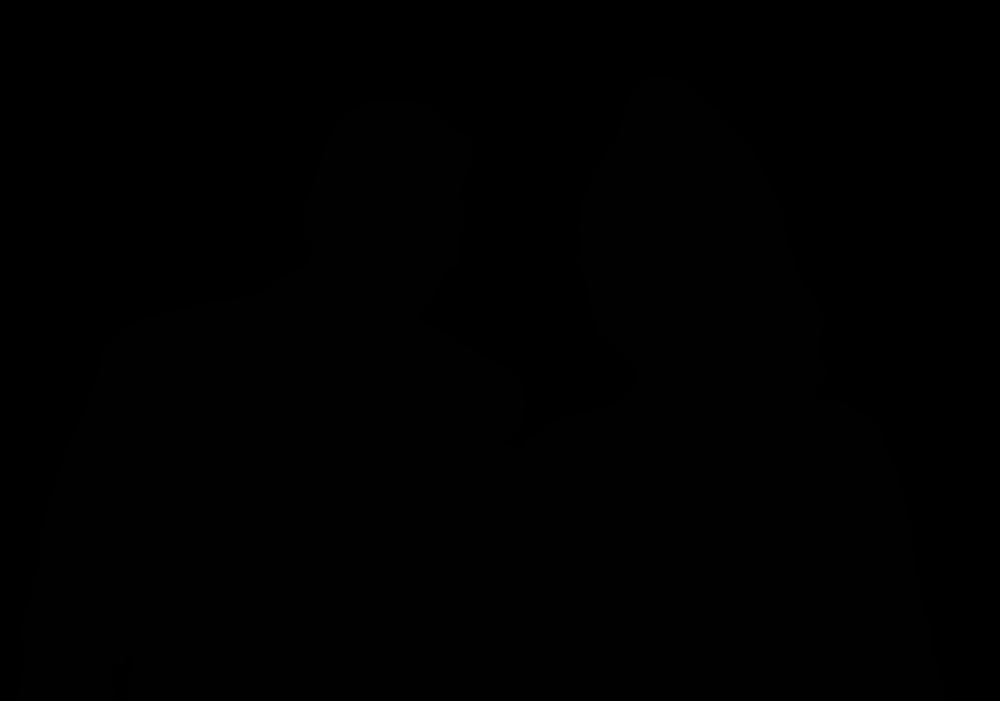

In [ ]:
cv2_imshow(photo_mask)

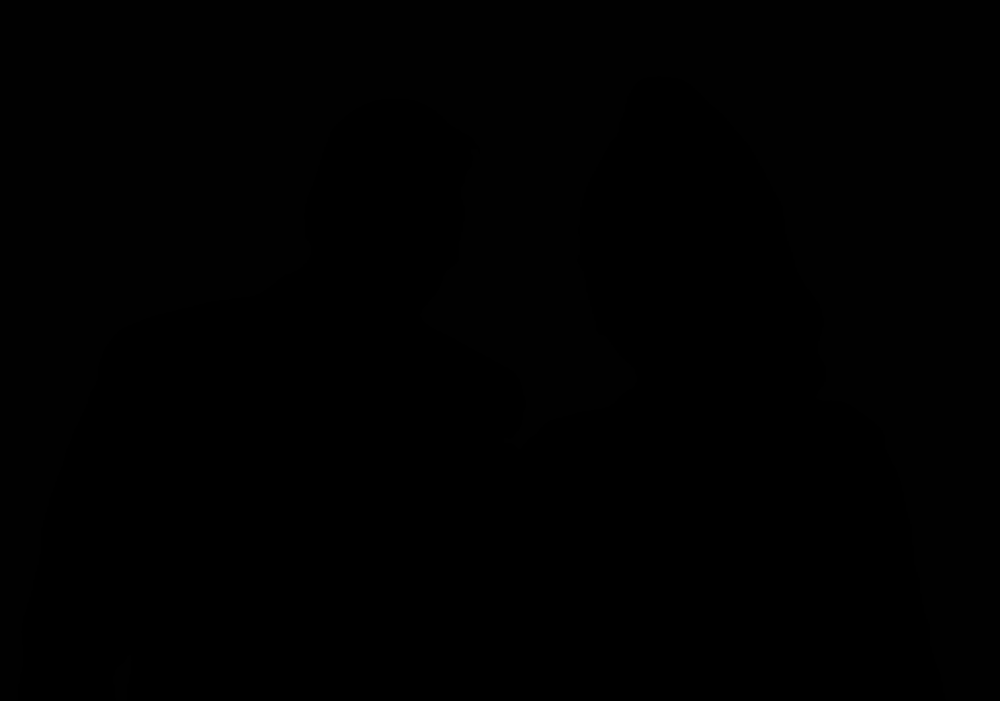

In [ ]:
cv2_imshow(background_mask)

In [ ]:
masked_photo = image * photo_mask
background_mask = np.concatenate([background_mask, background_mask, background_mask], axis=-1)
#background_mask = background_mask * [0, 0, 255]
#final_photo = masked_photo + background_mask
#cv2.imwrite(f"remove_bg/{name}.png", final_photo)

In [ ]:
bgr_color = [139, 146, 28]

In [ ]:
background_mask = background_mask * bgr_color

final_photo = masked_photo + background_mask





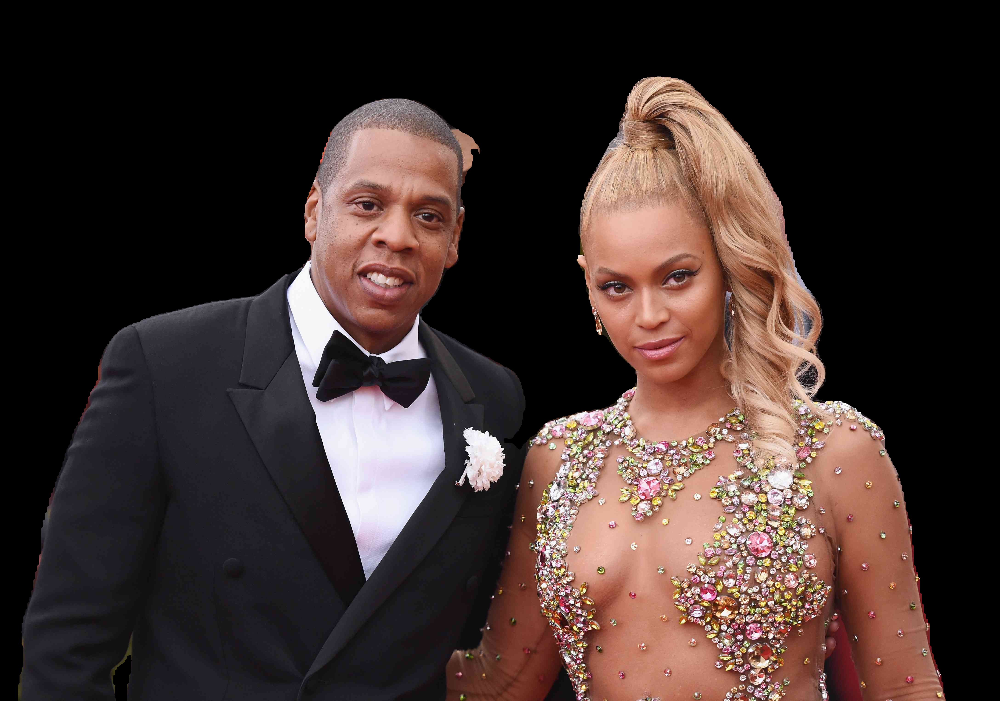

In [ ]:
cv2_imshow(masked_photo)



def change_background_color(image, img_mask, background_mask,
                            Blue_Green_Red_color: list = [0, 0, 255]
                            ):
  img_with_mask = image * img_mask
  background_mask_concat = np.concatenate([background_mask, background_mask,
                                           background_mask
                                           ],
                                            axis=-1
                                          )
  background_mask_concat_with_color = background_mask_concat * Blue_Green_Red_color
  img_with_background_changed = img_with_mask + background_mask_concat_with_color
  return img_with_background_changed







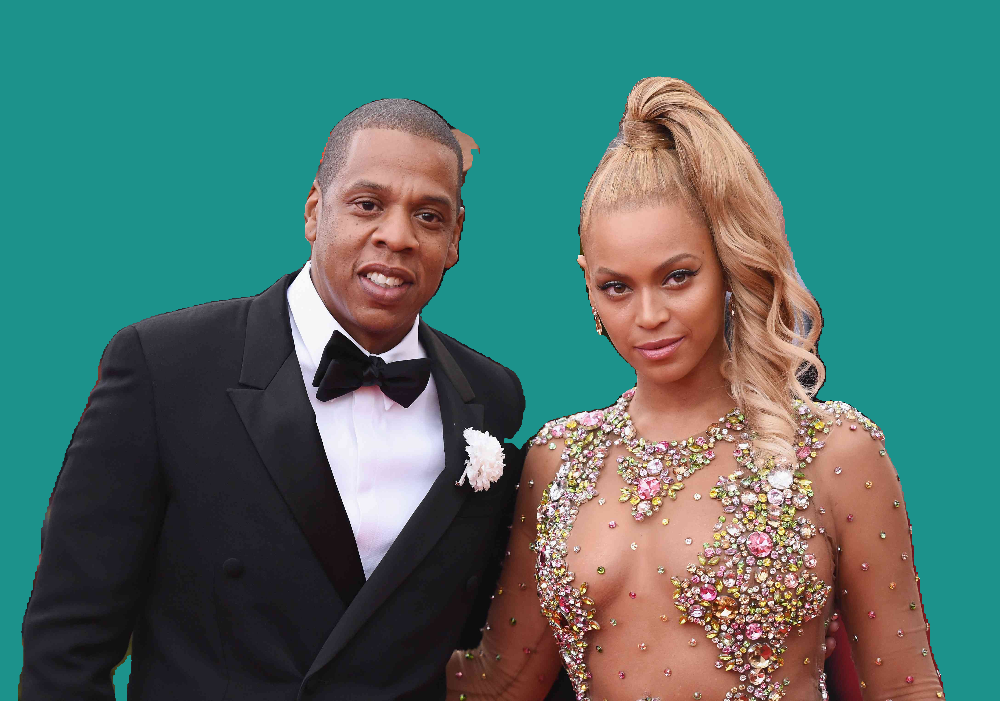

In [ ]:
cv2_imshow(final_photo)

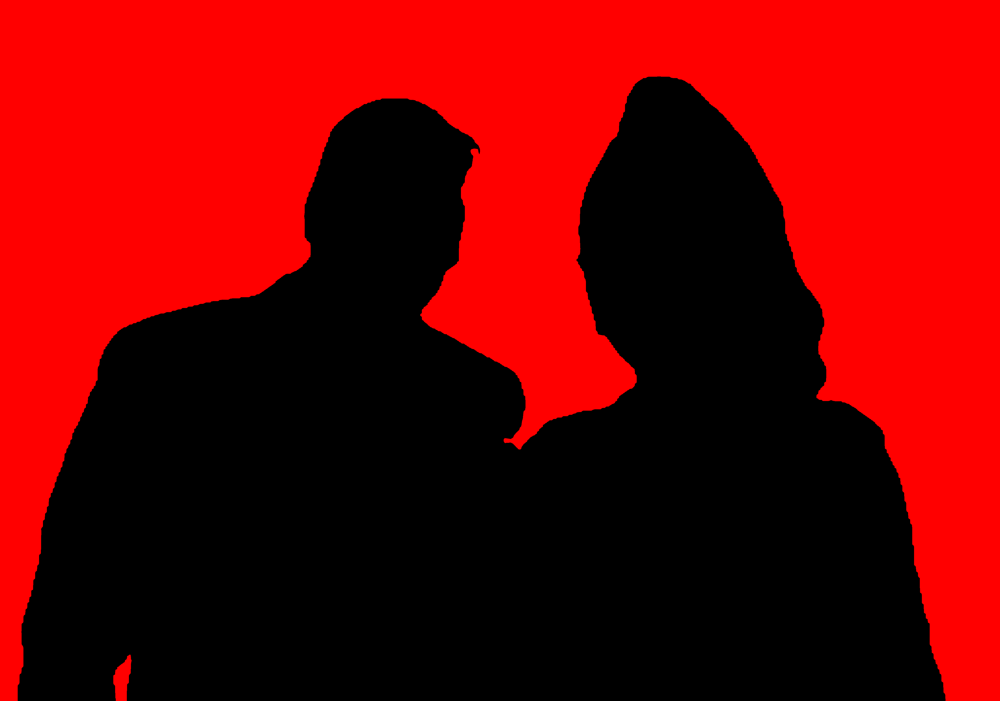

In [ ]:
cv2_imshow(background_mask)

In [ ]:
bg_mask_chg = background_mask * [139, 146, 28]

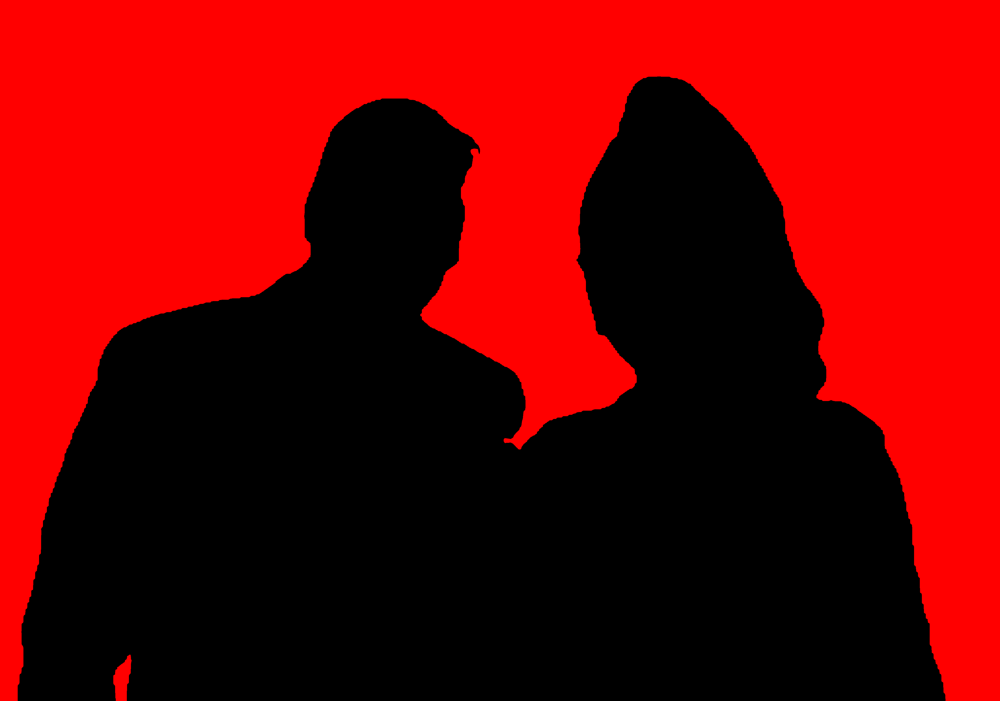

In [ ]:
cv2_imshow(bg_mask_chg)

In [63]:
class ImageBackgroundChanger(object):
  DEFAULT_IMG_HEIGHT = 512
  DEFAULT_IMG_WIDTH = 512
  def __init__(self, image_path = None, image = None):
    if (image_path and not image) or (image_path and image):
      self.image = cv2.imread(image_path, cv2.IMREAD_COLOR)

    if (not image_path and image) or (image_path and image):
      self.image = image

  def load_model(self, model_path):
    self.model_path = model_path
    with CustomObjectScope({'iou': iou, 'dice_coef': dice_coef,
                            'dice_loss': dice_loss}
                           ):
        self.model = tf.keras.models.load_model(self.model_path)
    return self.model


  def image_preprocess(self):
    self.img_height, self.img_width, _ = self.image.shape
    image_resize = cv2.resize(self.image, (self.DEFAULT_IMG_WIDTH, self.DEFAULT_IMG_HEIGHT))
    image_rescale = image_resize/255.0
    img_type_converted = image_rescale.astype(np.float32)
    self.preprocessed_img = np.expand_dims(img_type_converted, axis=0)
    return self.preprocessed_img


  def segment_image(self, model = None, preprocessed_img = None,
                    #img_resize_height=None,
                    #img_resize_width=None
                    ):
    if model:
      self.model = model

    if preprocessed_img:
      self.preprocessed_img = preprocessed_img

    img_predicted = self.model.predict(self.preprocessed_img)[0]
    img_predicted_resize = cv2.resize(img_predicted,
                                      (self.img_width,
                                       self.img_height
                                       )
                                      )
    img_predicted_expand = np.expand_dims(img_predicted_resize, axis=-1)
    self.img_mask = img_predicted_expand > 0.5
    self.background_mask = np.abs(1-self.img_mask)


  def change_background_color(self, #image, img_mask, background_mask,
                              Blue_Green_Red_color: list = [0, 0, 255]
                              ):
    #if image:
    #  self.image = image

    img_with_mask = self.image * self.img_mask
    background_mask_concat = np.concatenate([self.background_mask,
                                             self.background_mask,
                                            self.background_mask
                                            ],
                                              axis=-1
                                            )
    background_mask_concat_with_color = (background_mask_concat *
                                         Blue_Green_Red_color
                                         )
    image_with_background_changed = img_with_mask + background_mask_concat_with_color
    return image_with_background_changed












In [64]:
img_bgrd_rm = ImageBackgroundChanger(image_path="/content/Remove-Photo-Background-using-TensorFlow/images/beyonceandjay-z-Mikecoppola-c59229db80174b3290431f66eea3d8ff.jpg"
)

In [65]:
model = img_bgrd_rm.load_model(model_path="model.h5")






In [66]:
preprocessed_img = img_bgrd_rm.image_preprocess()

In [67]:
img_bgrd_rm.segment_image()

1/1 [==============================] - 6s 6s/step


In [68]:
img_chg_color = img_bgrd_rm.change_background_color(Blue_Green_Red_color=[90,192,82])

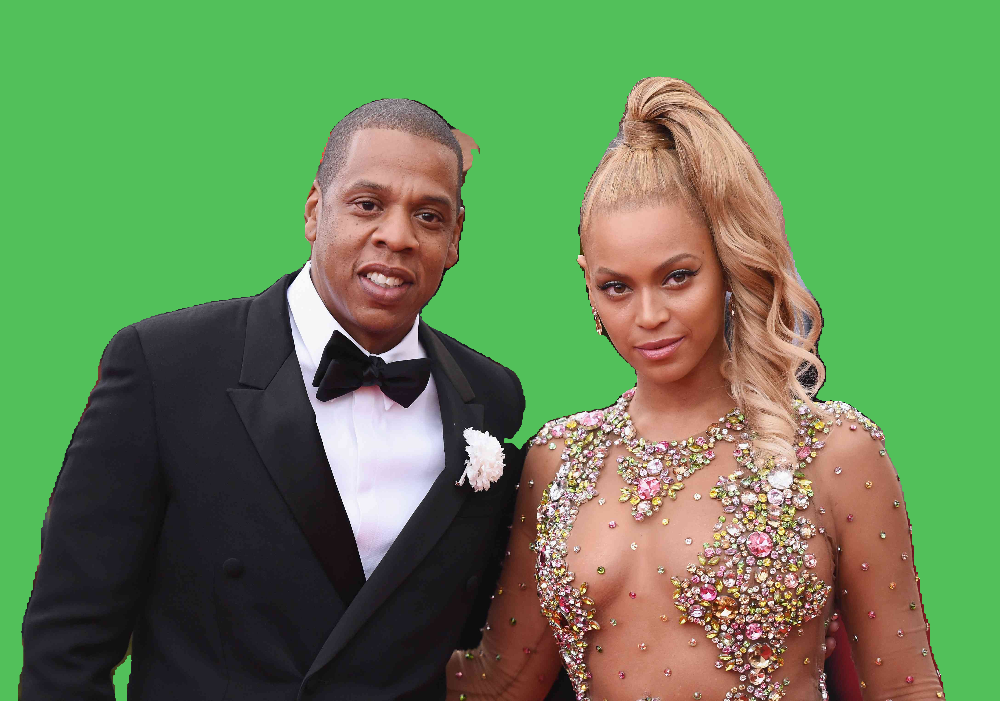

In [69]:
cv2_imshow(img_chg_color)

In [58]:
img_bgrd_rm.change_background_color()

array([[[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       ...,

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]],

       [[  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255],
        ...,
        [  0,   0, 255],
        [  0,   0, 255],
        [  0,   0, 255]]

Develop flask api

In [60]:
!pip3 install flask_restful

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.8/52.8 kB 4.3 MB/s eta 0:00:00


In [61]:
import joblib
import warnings
from flask import Flask, request, jsonify
from flask_restful import Resource, Api

In [62]:
warnings.filterwarnings('ignore')

In [71]:
model_path = "model.h5"
app = Flask(__name__)

api = Api(app)

# develop flask api for image background remove
class ImageBackgroundRemover(Resource):
  @staticmethod
  def post():
    user_input = request.get_json()
    image = user_input['image']
    blue_green_red_color = user_input['blue_green_red_color']

    img_bgrd_rm = ImageBackgroundChanger(image=image)
    model = img_bgrd_rm.load_model(model_path=model_path)
    preprocessed_img = img_bgrd_rm.image_preprocess()
    img_bgrd_rm.segment_image()
    image_with_background_changed = img_bgrd_rm.change_background_color(Blue_Green_Red_color=blue_green_red_color)
    new_background_json = {'processed_image': image_with_background_changed}
    return jsonify(new_background_json)

api.add_resource(resource = ImageBackgroundRemover, url='/remove_background')

if __name__ == '__main__':
    app.run(host='0.0.0.0', port=8010)






 * Serving Flask app '__main__'
 * Debug mode: off


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on all addresses (0.0.0.0)
 * Running on http://127.0.0.1:8010
 * Running on http://172.28.0.12:8010
INFO:werkzeug:Press CTRL+C to quit


In [ ]:
# develop flask api for image background remove

import joblib
import warnings
from flask import Flask, request, jsonify
from flask_restful import Resource, Api
from .helpers import predict_booking, get_path

warnings.filterwarnings('ignore')

model_path = get_path(folder_name='booking_gauger/api/model_store', file_name='best_model.model')
model = joblib.load(filename=model_path)

#%%
app = Flask(__name__)
api = Api(app)
class predictBookingDays(Resource):
    @staticmethod
    def post():
        user_input = request.get_json()
        num_sessions = user_input['num_sessions']
        city = user_input['city']
        country = user_input['country']
        device = user_input['device_class']
        instant_booking = user_input['instant_booking']
        user_verified = user_input['user_verified']
        prediction = predict_booking(model=model,
                                     num_sessions=num_sessions,
                                     city=city,
                                     country=country,
                                     device_class=device,
                                     instant_booking=instant_booking,
                                     user_verified=user_verified
                                     )
        prediction_json = {'predicted_value': prediction}
        return jsonify(prediction_json)

api.add_resource(predictBookingDays, '/predict')

if __name__ == '__main__':
    app.run(host='0.0.0.0', port=8080)







In [ ]:
# func to make request to background remover api

def request_image_background_change(data: dict, URL: str = DEFAULT_URL,) -> int:
    """
    This function makes an API request to the image background change API
    and returnsan image with the changed to what user requested

    Parameters
    ----------
    URL : Endpoint of image background color change API
        The API link.
    data : dict
        input data to be used for prediction. This should be a dictionary
        composed of image and color to change image background to.
        keys as image and blue_green_red_color
        image: image whose background is to be changed

        blue_green_red_color: Background color to change image background to.
          This is a list of pixel values (intergers) ideally in the range of 0 - 255
    Returns
    -------
    NdArray
        Image.

    """
    req = requests.post(url=URL, json=data)
    response = req.content
    prediction = json.loads(response)['processed_image'][0]
    return prediction


In [ ]:
#%%
import joblib
import os
import requests
import json
import pandas as pd

def get_path(folder_name: str, file_name: str):
    cwd = os.getcwd()
    return f"{cwd}/{folder_name}/{file_name}"

DEFAULT_URL = "http://192.168.0.168:8080/predict"

#%%
model_path = get_path(folder_name='booking_gauger/api/model_store',
                      file_name='best_model.model'
                    )
model = joblib.load(filename=model_path)

def predict_booking(device_class, city, country,
                    instant_booking, user_verified,
                    num_sessions, model=model
                    ):
        in_data = {'num_sessions': num_sessions, 'city': city, 'country': country,
                    'device_class': device_class, 'instant_booking': instant_booking,
                    'user_verified': user_verified
                    }

        prediction_input_data = pd.DataFrame(data=in_data, index=[0])
        prediction = model.predict(prediction_input_data)
        return prediction.tolist()


def request_prediction(data: dict, URL: str = DEFAULT_URL,) -> int:
    """
    This function makes an API request to the booking gauger API and return
    a prediction of number of days room will be booked for accommodation.

    Parameters
    ----------
    URL : Endpoint of booking gauger API
        The API link.
    data : dict
        input data to be used for prediction. This should be a dictionary
        with keys as num_sessions, city_encoded, country_encoded,
         device_class_encoded, instant_booking_encoded and user_verified_encoded

        num_sessions: is the number of sessions of an online client using platform
                      for booking accommodation
        city_encoded: City from which client is accessing the online booking platform
        country_encoded: Country from which client is accessing the online booking platform
        device_class_encoded: Type of Device used by client to access the online booking platform
        instant_booking_encoded: Whether client used instant booking button for the booking
        user_verified_encoded: Whether the user is verified

    Returns
    -------
    int
        prediction.

    """
    req = requests.post(url=URL, json=data)
    response = req.content
    prediction = json.loads(response)['predicted_value'][0]
    return prediction



In [ ]:
# TO DO:
# test the class and debug. ---
# develop flask api  ---
# test flask api locally
# develop web app
# deploy flask api on AWS EC2
# deploy web app
# test flask api on web app

In [ ]:
ls

images/     model.h5      README.md   run.py
metrics.py  __pycache__/  remove_bg/  view


**user expectation**

1. User uploads an image and specifies the background color to use
2. The background of the picture is
change with what the user specified
3. The image is returned to the user


**Expected tool to develop**
-- Rest API with flask / web app

**Web app user interface**

- Built with plotly dash
-
**Features**
- Has pop-ups: that prevent background removal request from being sent to API when image is not uploaded before clicking on background removal button

- Image upload button
- Column to show image upload
- Background remove button
- Background colour select dropdown
- Column to show image with background removed and replaced selected background colour


Process for background removal
- Using the web app **bold text**

1. User uploads the image
2. Uploaded image is shown on web app to user
3. User selects background color to use
4. User clicks remove background color button

5. The image and background to change to are extracted as parameters
6. The parameters are sent to background remove API

**Background remove API workflow**
7. The image is preprocessed
8. Image is fed into the model for
semantic segmentation
9. The background and foreground mask are detected and the background color is change to the user defined colour by matrix multiplication
10. The process image (background removed and changed to user defined color) is returned to the web app as API response
11. The API response is displayed in column for user  